<a href="https://colab.research.google.com/github/pauljohn99/ClassSpringBoot/blob/main/Copy_of_Copy_of_Copy_of_Copy_of_Detectron2_Tutorial.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Detectron2 Beginner's Tutorial

<img src="https://dl.fbaipublicfiles.com/detectron2/Detectron2-Logo-Horz.png" width="500">

Welcome to detectron2! This is the official colab tutorial of detectron2. Here, we will go through some basics usage of detectron2, including the following:
* Run inference on images or videos, with an existing detectron2 model
* Train a detectron2 model on a new dataset

You can make a copy of this tutorial by "File -> Open in playground mode" and make changes there. __DO NOT__ request access to this tutorial.


# Install detectron2

In [1]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities.
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 KB 15.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyyaml: filename=PyYAML-5.1-cp39-cp39-linux_x86_64.whl size=44089 sha256=c32bec4d7254fbc3265ca335feb292bca1eedd0b84b617c4e06c78de658e302e
  Stored in directory: /root/.cache/pip/wheels/68/be/8f/b6c454cd264e0b349b47f8ee00755511f277618af9e5dae20d
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask 2022.12.1 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.
Cloning into 'detectron2'...
remote: Enumerating objects: 14935, done.
remote: Co

In [2]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  1.13 ; cuda:  cu116
detectron2: 0.6


In [3]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Run a pre-trained detectron2 model

We first download an image from the COCO dataset:

# Train on a custom dataset

In this section, we show how to train an existing detectron2 model on a custom dataset in a new format.

We use [the balloon segmentation dataset](https://github.com/matterport/Mask_RCNN/tree/master/samples/balloon)
which only has one class: balloon.
We'll train a balloon segmentation model from an existing model pre-trained on COCO dataset, available in detectron2's model zoo.

Note that COCO dataset does not have the "balloon" category. We'll be able to recognize this new class in a few minutes.

## Prepare the dataset

Register the balloon dataset to detectron2, following the [detectron2 custom dataset tutorial](https://detectron2.readthedocs.io/tutorials/datasets.html).
Here, the dataset is in its custom format, therefore we write a function to parse it and prepare it into detectron2's standard format. User should write such a function when using a dataset in custom format. See the tutorial for more details.


In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
from detectron2.structures import BoxMode

def load_data(annotation_json, images_dir):
   
    json_file = open(annotation_json)
    coco_json = json.load(json_file)
    json_file.close()

    dataset_dicts = []
    for category in coco_json['categories']:
            class_id = category['id']
            class_name = category['name']
    
    for image in coco_json['images']:
        record = {}
        record["image_id"]=image['id']
        
        record["height"]= image['height']
        record["width"]= image['width']
        print("record1111111",record)


        image_file_name = image['file_name']
        image_file_name = image_file_name.split('-',1)[1]
        print("image_file_name=",image_file_name)
        image_path = os.path.abspath(os.path.join(images_dir, image_file_name))
        record["file_name"] =image_path
        print("record222222",record)
        objs = []
        annotations = {}
        for annotation in coco_json['annotations']:
             if(record["image_id"]==annotation['image_id']):
                segmentation=annotation["segmentation"]
                # print("segmenation====",segmentation)
                
                all_x = []
                all_y = []
                for i in range(0, len(segmentation[0])):
                   if i % 2:
                    all_y.append(segmentation[0][i])
                   else :
                    all_x.append(segmentation[0][i])
                # print("all_x===", all_x)   

               


                obj={
                    "bbox": [np.min(all_x), np.min(all_y), np.max(all_x), np.max(all_y)],
                    "bbox_mode": BoxMode.XYXY_ABS,
                    "segmentation":segmentation,
                    "category_id": 0,
                }
                objs.append(obj)
        record["annotations"] = objs
        print("record===",record["annotations"])
        dataset_dicts.append(record)
        print("dataset====",dataset_dicts)
    return dataset_dicts
                  
for d in ["train", "val"]:
    DatasetCatalog.register("balloon_" + d, lambda d=d: load_data("/content/drive/MyDrive/result.json", "/content/drive/MyDrive/teeth-mask-rcnn"))
    MetadataCatalog.get("balloon_" + d).set(thing_classes=["teeth"])
balloon_metadata = MetadataCatalog.get("balloon_train")

In [6]:
# # if your dataset is in COCO format, this cell can be replaced by the following three lines:
# # from detectron2.data.datasets import register_coco_instances
# # register_coco_instances("my_dataset_train", {}, "json_annotation_train.json", "path/to/image/dir")
# # register_coco_instances("my_dataset_val", {}, "json_annotation_val.json", "path/to/image/dir")

# from detectron2.structures import BoxMode

# def get_balloon_dicts(img_dir):
#     json_file = os.path.join(img_dir, "via_region_data.json")
#     with open(json_file) as f:
#         imgs_anns = json.load(f)
#     dataset_dicts = []
#     record = {}
#     for idx, v in enumerate(imgs_anns.values()):
        
        
#         filename = os.path.join(img_dir, v["filename"])
#         height, width = cv2.imread(filename).shape[:2]
        
#         record["file_name"] = filename
#         record["image_id"] = idx
#         record["height"] = height
#         record["width"] = width
      
#         annos = v["regions"]
#         objs = []
#         for _, anno in annos.items():
#             assert not anno["region_attributes"]
#             anno = anno["shape_attributes"]
#             px = anno["all_points_x"]
#             py = anno["all_points_y"]
#             poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
#             print("poly======",poly)
#             poly = [p for x in poly for p in x]
#             print("poly1======",poly)

#             obj = {
#                 "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
#                 "bbox_mode": BoxMode.XYXY_ABS,
#                 "segmentation": [poly],
#                 "category_id": 0,
#             }
#             objs.append(obj)
#         record["annotations"] = objs
#         print("record",record["annotations"])
#         dataset_dicts.append(record)
#         print("dataset=",dataset_dicts)
#     return dataset_dicts

# for d in ["train", "val"]:
#     DatasetCatalog.register("balloon_" + d, lambda d=d: get_balloon_dicts("balloon/" + d))
#     MetadataCatalog.get("balloon_" + d).set(thing_classes=["balloon"])
# balloon_metadata = MetadataCatalog.get("balloon_train")

In [7]:
# load_data("/content/drive/MyDrive/result.json", "/content/drive/MyDrive/teeth-mask-rcnn")

To verify the dataset is in correct format, let's visualize the annotations of randomly selected samples in the training set:



In [8]:
# dataset_dicts = get_balloon_dicts("balloon/train")
# for d in random.sample(dataset_dicts, 3):
#     img = cv2.imread(d["file_name"])
#     visualizer = Visualizer(img[:, :, ::-1], metadata=balloon_metadata, scale=0.5)
#     out = visualizer.draw_dataset_dict(d)
#     cv2_imshow(out.get_image()[:, :, ::-1])

record1111111 {'image_id': 0, 'height': 4000, 'width': 6000}
image_file_name= COMPOSITE_PHOTO-CAZFG41770_310721041401.jpeg
record222222 {'image_id': 0, 'height': 4000, 'width': 6000, 'file_name': '/content/drive/MyDrive/teeth-mask-rcnn/COMPOSITE_PHOTO-CAZFG41770_310721041401.jpeg'}
record=== [{'bbox': [2665.2520487291395, 2766.179013894782, 2725.3200532305273, 2836.6580369111057], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[2722.213087480456, 2836.6580369111057, 2699.4286719799293, 2824.220562261166, 2670.4303249792592, 2812.819543832055, 2665.2520487291395, 2792.0904194154896, 2668.3590144792115, 2766.179013894782, 2680.786877479499, 2768.251926336439, 2692.1790852297618, 2783.798769648863, 2704.606948230049, 2799.3456129612873, 2725.3200532305273, 2808.673718948742, 2724.2465081542623, 2818.343097106467]], 'category_id': 0}, {'bbox': [2730.498329480648, 2778.6164885447215, 2775.0315052316764, 2858.4236175485], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[2730.49832

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ddddd= {'image_id': 62, 'height': 1680, 'width': 2520, 'file_name': '/content/drive/MyDrive/teeth-mask-rcnn/COMPOSITE_PHOTO-TAFHL10134_030821010413.jpeg', 'annotations': [{'bbox': [612.272589046519, 1074.9258568797097, 656.3120411745537, 1165.1369109449167], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[612.272589046519, 1074.9258568797097, 632.0903425041346, 1074.9258568797097, 647.5041507489467, 1094.728283381828, 656.3120411745537, 1147.5347540541445, 638.6962603233397, 1165.1369109449167, 614.4745616529207, 1134.3331363860655]], 'category_id': 0}, {'bbox': [654.1100685681517, 1070.5253176570166, 698.1495206961865, 1189.3398766697283], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[654.1100685681517, 1096.9285529931747, 658.5140137809555, 1070.5253176570166, 691.5436028769813, 1118.9312491066403, 698.1495206961865, 1173.9379893903026, 669.5238768129641, 1189.3398766697283, 662.9179589937588, 1158.5361021108768]], 'category_id': 0}, {'bbox': [695.9475480897848, 1090.32

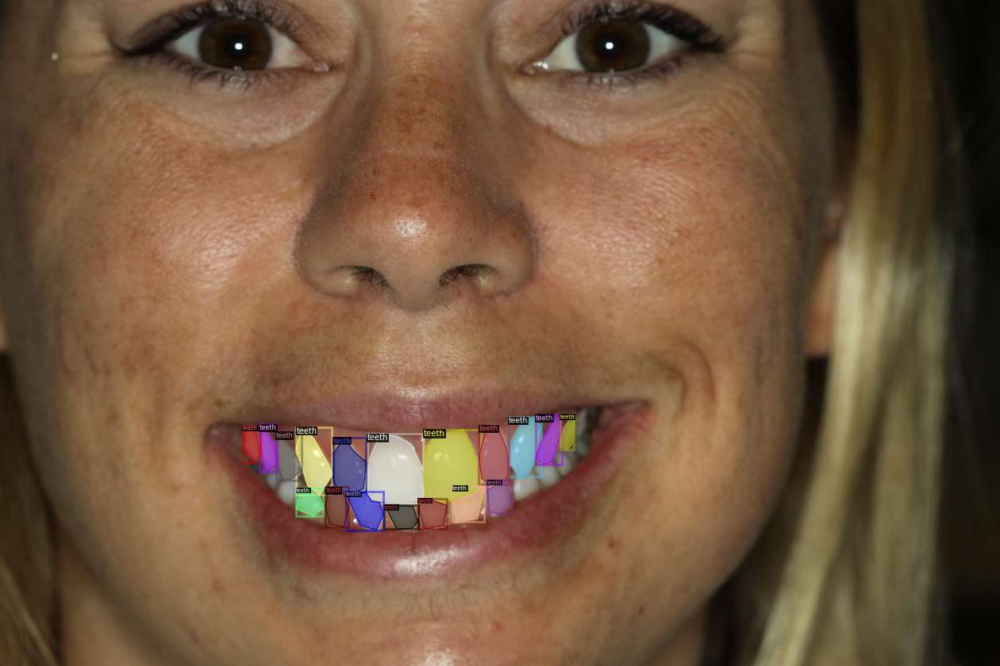

In [9]:
dataset_dicts = load_data("/content/drive/MyDrive/result.json", "/content/drive/MyDrive/teeth-mask-rcnn")
for d in random.sample(dataset_dicts, 1):
    print("aaaaaaaaaaaaa=",d)
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=balloon_metadata, scale=0.5)
    print("ddddd=",d)
    out = visualizer.draw_dataset_dict(d)
    print(out.get_image())
    cv2_imshow(out.get_image()[:, :, ::-1])

## Train!

Now, let's fine-tune a COCO-pretrained R50-FPN Mask R-CNN model on the balloon dataset. It takes ~2 minutes to train 300 iterations on a P100 GPU.


In [10]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("balloon_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2  # This is the real "batch size" commonly known to deep learning people
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 600    # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512   # The "RoIHead batch size". 128 is faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class (ballon). (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[03/23 04:41:06 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[03/23 04:41:11 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


model_final_f10217.pkl: 178MB [00:01, 162MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[03/23 04:41:15 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.9/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3190.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[03/23 04:41:56 d2.utils.events]:  eta: 0:12:34  iter: 19  total_loss: 5.521  loss_cls: 0.6839  loss_box_reg: 0.1158  loss_mask: 0.6883  loss_rpn_cls: 3.71  loss_rpn_loc: 0.4492    time: 1.4406  last_time: 1.3113  data_time: 0.9888  last_data_time: 0.8057   lr: 8.1588e-06  max_mem: 2758M
[03/23 04:42:18 d2.utils.events]:  eta: 0:08:23  iter: 39  total_loss: 1.989  loss_cls: 0.5493  loss_box_reg: 0.3558  loss_mask: 0.6692  loss_rpn_cls: 0.1017  loss_rpn_loc: 0.2762    time: 1.2672  last_time: 0.5582  data_time: 0.6412  last_data_time: 0.1231   lr: 1.6484e-05  max_mem: 2758M
[03/23 04:42:33 d2.utils.events]:  eta: 0:07:14  iter: 59  total_loss: 1.725  loss_cls: 0.384  loss_box_reg: 0.3653  loss_mask: 0.6277  loss_rpn_cls: 0.05299  loss_rpn_loc: 0.2621    time: 1.0776  last_time: 0.4214  data_time: 0.2356  last_data_time: 0.0132   lr: 2.4809e-05  max_mem: 2758M
[03/23 04:42:46 d2.utils.events]:  eta: 0:05:44  iter: 79  total_loss: 1.523  loss_cls: 0.3132  loss_box_reg: 0.2998  loss_mask: 

In [11]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

## Inference & evaluation using the trained model
Now, let's run inference with the trained model on the balloon validation dataset. First, let's create a predictor using the model we just trained:



In [46]:
from detectron2.modeling import build_model
model = build_model(cfg)

In [53]:
from detectron2.checkpoint import DetectionCheckpointer
DetectionCheckpointer(model).load("/content/output/model_final.pth")  # load a file, usually from cfg.MODEL.WEIGHTS

checkpointer = DetectionCheckpointer(model, save_dir="output")
checkpointer.save("model_999.pth")

[03/23 05:40:15 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/output/model_final.pth ...


roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


In [54]:
from detectron2.engine import DefaultPredictor

In [ ]:
predictor = DefaultPredictor(cfg)


In [45]:
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor
from detectron2.checkpoint import DetectionCheckpointer

# Load the configuration and model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.WEIGHTS = "model_999.pth"
model = build_model(cfg)

# Load the weights into the model
checkpointer = DetectionCheckpointer(model)
checkpointer.load("/content/output/model_999.pth")

# Create a default predictor for the model
predictor = DefaultPredictor(cfg)

[03/23 05:39:07 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/output/model_999.pth ...


roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[03/23 05:39:08 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from model_999.pth ...


AssertionError: ignored

In [32]:
im = cv2.imread("/content/drive/MyDrive/teeth-mask-rcnn/COMPOSITE_PHOTO-SQMKV21617_040821111731.jpeg")

In [33]:
model.eval()
with torch.no_grad():
  outputs = model(im)

IndexError: ignored

In [21]:
output_dir = "/content/my_model_output_dir"
os.makedirs(output_dir, exist_ok=True)

In [22]:
model_weights = os.path.join(output_dir, "model_weights.pth")
torch.save(trainer.model.state_dict(), model_weights)

In [26]:
cfg_file = detectron2.model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg = get_cfg()
cfg.merge_from_file(cfg_file)
model = build_model(cfg)
model_weights = '/content/my_model_output_dir/model_weights.pth'
model.load_state_dict(torch.load(model_weights))

RuntimeError: ignored

In [18]:
torch.save(model.state_dict(), '/content/drive/MyDrive/model_weights.pth')

In [20]:
import torch
import detectron2

# Define your model architecture
model = ("/content/detectron2/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # replace with your actual model architecture

# Load the saved weights into the model
model_weights = '/content/drive/MyDrive/model_weights.pth'
model.load_state_dict(torch.load(model_weights))

# Set the model to evaluation mode
model.eval()

AttributeError: ignored

In [12]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

[03/15 10:40:25 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


Then, we randomly select several samples to visualize the prediction results.

In [13]:
import cv2
from google.colab.patches import cv2_imshow


In [14]:
def polygon_centroid(points):
    n = len(points)
    # print("points",points),
    area = 0.0
    x = 0.0
    y = 0.0
    print("len",n)
    for i in range(n):
        j = (i + 1) % n
        area += points[i][0][0] * points[j][0][1] - points[j][0][0] * points[i][0][1]
        x += (points[i][0][0] + points[j][0][0]) * (points[i][0][0] * points[j][0][1] - points[j][0][0] * points[i][0][1])
        y += (points[i][0][1] + points[j][0][1]) * (points[i][0][0] * points[j][0][1] - points[j][0][0] * points[i][0][1])

    area *= 0.5
    x /= 6 * area
    y /= 6 * area

    return (x, y)


record1111111 {'image_id': 0, 'height': 4000, 'width': 6000}
image_file_name= COMPOSITE_PHOTO-CAZFG41770_310721041401.jpeg
record222222 {'image_id': 0, 'height': 4000, 'width': 6000, 'file_name': '/content/drive/MyDrive/teeth-mask-rcnn/COMPOSITE_PHOTO-CAZFG41770_310721041401.jpeg'}
record=== [{'bbox': [2665.2520487291395, 2766.179013894782, 2725.3200532305273, 2836.6580369111057], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[2722.213087480456, 2836.6580369111057, 2699.4286719799293, 2824.220562261166, 2670.4303249792592, 2812.819543832055, 2665.2520487291395, 2792.0904194154896, 2668.3590144792115, 2766.179013894782, 2680.786877479499, 2768.251926336439, 2692.1790852297618, 2783.798769648863, 2704.606948230049, 2799.3456129612873, 2725.3200532305273, 2808.673718948742, 2724.2465081542623, 2818.343097106467]], 'category_id': 0}, {'bbox': [2730.498329480648, 2778.6164885447215, 2775.0315052316764, 2858.4236175485], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[2730.49832

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[{'image_id': 0, 'height': 4000, 'width': 6000, 'file_name': '/content/drive/MyDrive/teeth-mask-rcnn/COMPOSITE_PHOTO-CAZFG41770_310721041401.jpeg', 'annotations': [{'bbox': [2665.2520487291395, 2766.179013894782, 2725.3200532305273, 2836.6580369111057], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[2722.213087480456, 2836.6580369111057, 2699.4286719799293, 2824.220562261166, 2670.4303249792592, 2812.819543832055, 2665.2520487291395, 2792.0904194154896, 2668.3590144792115, 2766.179013894782, 2680.786877479499, 2768.251926336439, 2692.1790852297618, 2783.798769648863, 2704.606948230049, 2799.3456129612873, 2725.3200532305273, 2808.673718948742, 2724.2465081542623, 2818.343097106467]], 'category_id': 0}, {'bbox': [2730.498329480648, 2778.6164885447215, 2775.0315052316764, 2858.4236175485], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'segmentation': [[2730.498329480648, 2838.730949352763, 2732.5696399806952, 2784.8352258696914, 2738.783571480839, 2778.6164885447215, 2746.0331582310064, 278

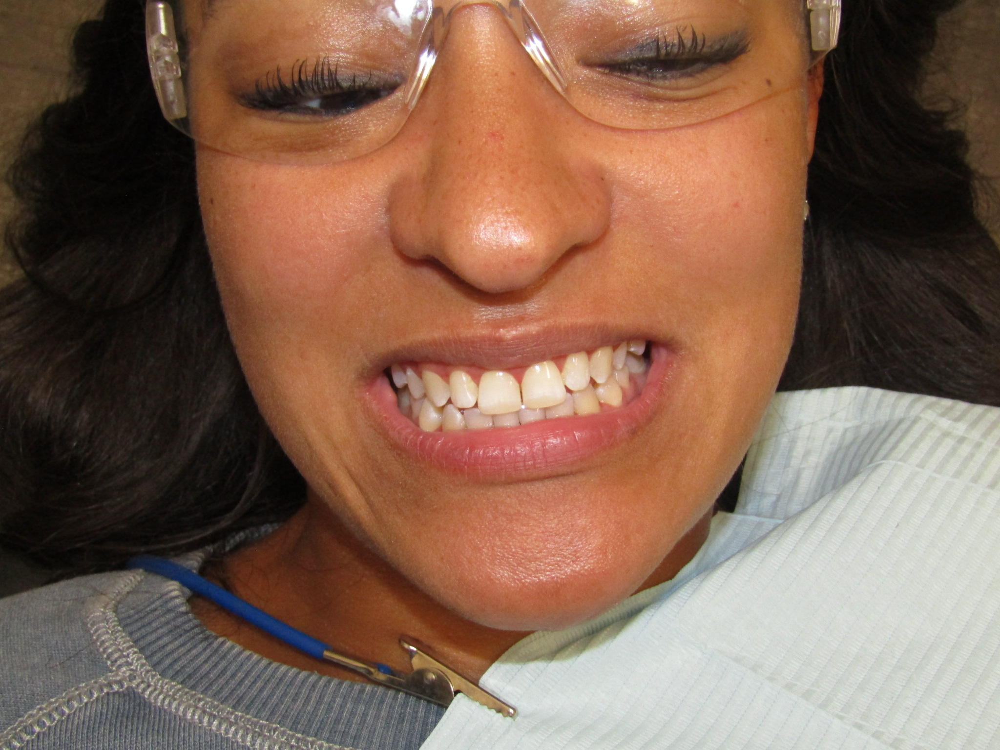

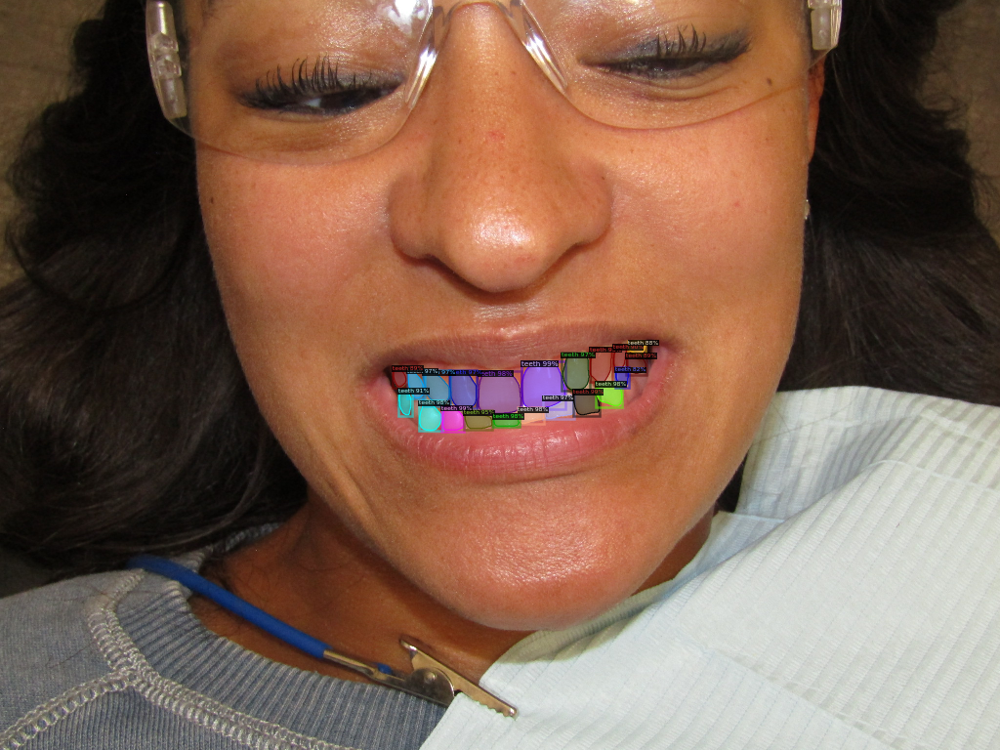

len 162
len 162
len 282
len 162
len 282
len 145
len 162
len 282
len 145
len 150
len 162
len 282
len 145
len 150
len 130
len 162
len 282
len 145
len 150
len 130
len 132
len 162
len 282
len 145
len 150
len 130
len 132
len 146
len 162
len 282
len 145
len 150
len 130
len 132
len 146
len 282
len 162
len 282
len 145
len 150
len 130
len 132
len 146
len 282
len 205
len 162
len 282
len 145
len 150
len 130
len 132
len 146
len 282
len 205
len 133
len 162
len 282
len 145
len 150
len 130
len 132
len 146
len 282
len 205
len 133
len 172
len 162
len 282
len 145
len 150
len 130
len 132
len 146
len 282
len 205
len 133
len 172
len 202
len 162
len 282
len 145
len 150
len 130
len 132
len 146
len 282
len 205
len 133
len 172
len 202
len 162
len 162
len 282
len 145
len 150
len 130
len 132
len 146
len 282
len 205
len 133
len 172
len 202
len 162
len 175
len 162
len 282
len 145
len 150
len 130
len 132
len 146
len 282
len 205
len 133
len 172
len 202
len 162
len 175
len 149
len 162
len 282
len 145
len 150
len 130


In [106]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = load_data("/content/drive/MyDrive/result.json", "/content/drive/MyDrive/teeth-mask-rcnn")

for d in random.sample(dataset_dicts, 1):    
    # im = cv2.imread(d["file_name"])
    im = cv2.imread("/content/drive/MyDrive/teeth-mask-rcnn/COMPOSITE_PHOTO-SQMKV21617_040821111731.jpeg")
    cv2_imshow(im)
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    # print("output========",outputs)
    v = Visualizer(im[:, :, ::-1],
                   metadata=balloon_metadata, 
                   scale=0.5, 
                  #  instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    # print("out===",outputs["instances"])
    cv2_imshow(out.get_image()[:, :, ::-1])

    contours = []
    for pred_mask in outputs['instances'].pred_masks:
    # pred_mask is of type torch.Tensor, and the values are boolean (True, False)
    # Convert it to a 8-bit numpy array, which can then be used to find contours

     mask = pred_mask.cpu().numpy().astype('uint8')
    #  print("kjdh==",mask)
     contour, _ = cv2.findContours(mask, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
    #  print("jhfjhjkfhjcke=====",contour)
     contours.append(contour[0]) 
    #  print("contours---",contours)
     centroid_points=[]
     for cont in contours:
      #  print("ooooooooo==",polygon_centroid(cont))
       centroid_points.append(polygon_centroid(cont))
      #  print("fffffffffff==",centroid_points)
      

In [16]:
print(d["file_name"])

/content/drive/MyDrive/teeth-mask-rcnn/COMPOSITE_PHOTO-QHNQE88620_040821011409.jpeg


In [17]:
b_box=outputs['instances'].pred_boxes.tensor

In [18]:
from torchvision.ops import box_area

In [94]:
area = box_area(b_box)
print("area==",area)
print(area[1])
area1=torch.argmax(area)
ar=area1.cpu().numpy()
print(ar)

area== tensor([2954.7275, 8844.2148, 2485.5925, 2941.8193, 1411.1497, 1797.5953,
        2816.3010, 7818.3354, 4468.9668, 2178.2080, 4068.4187, 4378.5234,
        3129.3691, 3313.5339, 2302.3828, 1612.0560, 1557.7335, 1249.8380,
        1819.8008, 1015.0773, 1196.6187], device='cuda:0')
tensor(8844.2148, device='cuda:0')
1


In [20]:

a=ar.item()
bboxmax=outputs['instances'][a].pred_boxes.tensor
print(bboxmax)

tensor([[1067.8893,  739.4327, 1158.3286,  837.2244]], device='cuda:0')


In [21]:
boxm=bboxmax.cpu().numpy()
print(boxm)
ymax=boxm[0][3]
print(ymax)

[[1067.8893   739.4327  1158.3286   837.22437]]
837.22437


In [22]:
print(b_box.cpu().numpy())

[[1173.1516   798.07574 1228.4321   851.52545]
 [1067.8893   739.4327  1158.3286   837.22437]
 [ 903.56024  831.3887   950.24194  884.6342 ]
 [ 857.7536   820.6037   905.7921   881.84247]
 [1010.4219   847.68677 1064.294    873.8812 ]
 [1060.5823   834.5928  1114.3822   868.0054 ]
 [1220.0125   781.68713 1274.753    833.13525]
 [ 978.8819   759.0658  1067.4696   847.3211 ]
 [1150.0457   722.4895  1208.3269   799.1688 ]
 [ 833.88983  755.44714  869.8445   816.02924]
 [ 866.27124  758.44226  921.50073  832.10614]
 [ 919.2983   758.8565   976.2337   835.7598 ]
 [1111.0236   810.53925 1176.2802   858.4941 ]
 [1207.0309   711.3346  1253.3062   782.93945]
 [ 949.9244   840.47656 1008.5322   879.7611 ]
 [ 815.5778   796.14014  844.8477   851.2157 ]
 [1255.171    706.265   1284.3873   759.5823 ]
 [ 803.9313   750.17816  832.8193   793.4431 ]
 [1282.0604   724.15906 1324.4417   767.0979 ]
 [1286.987    697.1857  1322.7012   725.60803]
 [1259.9124   752.6177  1288.5408   794.41595]]


In [23]:
bo=[]
bos=[]
boxes=b_box.cpu().numpy()
for boxs in boxes:
  bo.append(boxs[1])
  bos.append(boxs[0]+(boxs[2]-boxs[0])/2)
print(bo)
print(bos)


[798.07574, 739.4327, 831.3887, 820.6037, 847.68677, 834.5928, 781.68713, 759.0658, 722.4895, 755.44714, 758.44226, 758.8565, 810.53925, 711.3346, 840.47656, 796.14014, 706.265, 750.17816, 724.15906, 697.1857, 752.6177]
[1200.7918701171875, 1113.1089477539062, 926.9010925292969, 881.7728576660156, 1037.35791015625, 1087.4822387695312, 1247.3827514648438, 1023.1757507324219, 1179.186279296875, 851.8671569824219, 893.885986328125, 947.7659912109375, 1143.65185546875, 1230.1685180664062, 979.2283020019531, 830.2127685546875, 1269.7791748046875, 818.3752746582031, 1303.2510375976562, 1304.8441162109375, 1274.2265625]


In [24]:
upboxy=min(bo)
print(upboxy)
z=bo.index(upboxy)
upboxx=bos[z]
print(upboxx)

697.1857
1304.8441162109375


In [25]:
ymax1=ymax.copy()

In [26]:
# print(d["file_name"])

In [27]:
import locale
print(locale.getpreferredencoding())

ANSI_X3.4-1968


In [28]:
import locale
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding

In [29]:
!pip install mediapipe

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 33.0/33.0 MB 19.4 MB/s eta 0:00:00


In [30]:
import mediapipe as mp


In [31]:
mp_face_mesh = mp.solutions.face_mesh
face_mesh = mp_face_mesh.FaceMesh()

In [32]:
rgb_image = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
# Facial landmarks
result = face_mesh.process(rgb_image)

In [33]:
height, width, _ = im.shape

In [34]:

imgs=im.copy()

In [35]:

for facial_landmarks in result.multi_face_landmarks:
    sum=0
    sum1=0
    for i in range(0, 20):
        pt1 = facial_landmarks.landmark[i]
        x = int(pt1.x * width)
        y = int(pt1.y * height)
        # cv2.circle(im, (x, y), 5, (100, 100, 0), -1)
        # cv2.putText(im,str(i),(x,y),0,1,(0,0,0))
        if(i>=11 and i<=15):
          print(x,y)
          sum=sum+x
          sum1=sum1+y
    x1=sum/5
    y1=sum1/5
    print("x-avg=",x1)
    print("y-avg=",y1)      


          

1064 733
1066 750
1068 753
1078 901
1081 931
x-avg= 1071.4
y-avg= 813.6


In [36]:
308,78,14,13

(308, 78, 14, 13)

In [37]:
for facial_landmarks in result.multi_face_landmarks:
    img=im.copy()
    sumx=[]
    sumy=[]
    for i in range(0,462):
          if(i==308 or i==78):
               pt1 = facial_landmarks.landmark[i]
               x = int(pt1.x * width)
               sumx.append(x)
               cv2.circle(im, (x, y), 5, (100, 100, 0), -1)
               cv2.putText(im,str(i),(x,y),0,1,(0,0,0))
          if(i==14 or i==13):
               pt1 = facial_landmarks.landmark[i]
               y = int(pt1.y * width)
               sumy.append(y)
               cv2.circle(im, (x, y), 5, (100, 100, 0), -1)
               cv2.putText(im,str(i),(x,y),0,1,(0,0,0))
       
    print(sumx)
    print(sumy)
# cv2_imshow(im)  
# cv2_imshow(img)      

[794, 1343]
[1004, 1202]


In [38]:
valx=abs(sumx[1]-sumx[0])
valy=abs(sumy[1]-sumy[0])
print(valx,valy)

549 198


In [39]:
def find_closest(arr, val):
       print("arr1=",arr)
       arr = np.asarray(arr)
       print("arr2=",arr)
       idx1 = (np.abs(arr - val))
       idx = (np.abs(arr - val)).argmin()
       return idx1
       

In [40]:
cent1=[]
for cent in centroid_points:
      cent1.append(cent[0])
print("cc=",cent1)      
idx1=find_closest(cent1,x1)
print("kkk",idx1)
# print("pos1=",pos1)
# i=cent1.index(pos1)
# print("index=",i)

cc= [1200.0200989486705, 1110.7356589147287, 926.2680173661361, 879.5266632808532, 1036.6285323609845, 1085.336388888889, 1248.9832140891579, 1021.3373645754598, 1179.987246032923, 850.1698357262967, 893.0928589942976, 947.2807741428431, 1147.6722463318868, 1230.6550191880428, 977.0605873261205, 829.3731215846994, 1269.1804964539008, 817.1326530612245, 1301.5529030356618, 1305.1046539097567, 1274.31560807484]
arr1= [1200.0200989486705, 1110.7356589147287, 926.2680173661361, 879.5266632808532, 1036.6285323609845, 1085.336388888889, 1248.9832140891579, 1021.3373645754598, 1179.987246032923, 850.1698357262967, 893.0928589942976, 947.2807741428431, 1147.6722463318868, 1230.6550191880428, 977.0605873261205, 829.3731215846994, 1269.1804964539008, 817.1326530612245, 1301.5529030356618, 1305.1046539097567, 1274.31560807484]
arr2= [1200.02009895 1110.73565891  926.26801737  879.52666328 1036.62853236
 1085.33638889 1248.98321409 1021.33736458 1179.98724603  850.16983573
  893.09285899  947.2807

In [41]:
cent2=[]
for cent in centroid_points:
      cent2.append(cent[1])

In [42]:
import matplotlib.pyplot as plt
import numpy as np

In [43]:
xpoints = np.array(cent1)
ypoints = np.array(cent2)
print(centroid_points)


print(xpoints)
print(ypoints)

[(1200.0200989486705, 823.8211966604824), (1110.7356589147287, 789.6645833333333), (926.2680173661361, 857.7762662807526), (879.5266632808532, 853.530218384967), (1036.6285323609845, 860.5142813734427), (1085.336388888889, 850.3348611111111), (1248.9832140891579, 806.842047330765), (1021.3373645754598, 804.4309145880575), (1179.987246032923, 760.5111473626971), (850.1698357262967, 786.948906997801), (893.0928589942976, 795.1126231207879), (947.2807741428431, 797.2064053443364), (1147.6722463318868, 836.9062822897292), (1230.6550191880428, 746.0487443614085), (977.0605873261205, 859.6848016486347), (829.3731215846994, 822.7797131147541), (1269.1804964539008, 732.1813829787234), (817.1326530612245, 772.1045351473923), (1301.5529030356618, 745.8859416445623), (1305.1046539097567, 710.2336404441295), (1274.31560807484, 772.5406203840473)]
[1200.02009895 1110.73565891  926.26801737  879.52666328 1036.62853236
 1085.33638889 1248.98321409 1021.33736458 1179.98724603  850.16983573
  893.09285

In [44]:
xm=xpoints.max()
xl=xpoints.min()
ym=ypoints.max()
yl=ypoints.min()

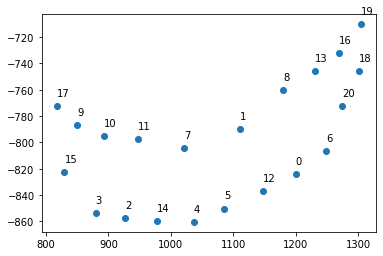

In [45]:
j=0
plt.plot(xpoints,-ypoints,'o')
for x,y in zip(xpoints,ypoints):
  label=j
  x=x
  y=-y
  j=j+1
  plt.annotate(label, # this is the text
                 (x,y), # these are the coordinates to position the label
                 textcoords="offset points", # how to position the text
                 xytext=(0,10) # distance from text to points (x,y)
                 )

In [46]:
for facial_landmarks in result.multi_face_landmarks:
    sum=[]
    a=[]
    b=[]
    img=im.copy()
    for i in range(0,462):
          if(i==308 or i==78 or i==191 or i==80 or i==81 or i==82 or i==13 or i==312 or i==311 or i==310 or i==415):
               pt1 = facial_landmarks.landmark[i]
               x = int(pt1.x * width)
               y = int(pt1.y * height)
               cv2.circle(img, (x, y), 5, (100, 100, 0), -1)
               cv2.putText(img,str(i),(x,y),0,1,(0,0,0))
               sum.append((x,y))
               a.append(x)
               b.append(y)
print(sum)
print(a)
print(b)
# cv2_imshow(im)  
# cv2_imshow(img)    

[(1068, 753), (794, 778), (871, 752), (922, 752), (987, 754), (828, 756), (1343, 730), (1262, 718), (1211, 727), (1147, 741), (1306, 714)]
[1068, 794, 871, 922, 987, 828, 1343, 1262, 1211, 1147, 1306]
[753, 778, 752, 752, 754, 756, 730, 718, 727, 741, 714]


In [47]:
aaa=a.copy()
bbb=b.copy()

In [48]:
print(a)
for i in range(0, len(a)):    
    for j in range(i+1, len(a)):    
        if(a[i] > a[j]):    
            temp = a[i];    
            a[i] = a[j];    
            a[j] = temp;    
     
print();    
     
#Displaying elements of the array after sorting    
    
print("Elements of array sorted in ascending order: ");    
print(a);    

[1068, 794, 871, 922, 987, 828, 1343, 1262, 1211, 1147, 1306]

Elements of array sorted in ascending order: 
[794, 828, 871, 922, 987, 1068, 1147, 1211, 1262, 1306, 1343]


In [49]:
add=[]
for i in a:
  for j in sum:
    if(i==j[0]):
      add.append(j)
print(add)


[(794, 778), (828, 756), (871, 752), (922, 752), (987, 754), (1068, 753), (1147, 741), (1211, 727), (1262, 718), (1306, 714), (1343, 730)]


In [50]:

x=[]
y=[]
for a in add:
  x.append(a[0])
  y.append(a[1])
print(x)
print(y)
print(add)

[794, 828, 871, 922, 987, 1068, 1147, 1211, 1262, 1306, 1343]
[778, 756, 752, 752, 754, 753, 741, 727, 718, 714, 730]
[(794, 778), (828, 756), (871, 752), (922, 752), (987, 754), (1068, 753), (1147, 741), (1211, 727), (1262, 718), (1306, 714), (1343, 730)]


In [51]:
xxx=x.copy()
yyy=y.copy()

In [52]:
print(cent1)
print(cent2)

[1200.0200989486705, 1110.7356589147287, 926.2680173661361, 879.5266632808532, 1036.6285323609845, 1085.336388888889, 1248.9832140891579, 1021.3373645754598, 1179.987246032923, 850.1698357262967, 893.0928589942976, 947.2807741428431, 1147.6722463318868, 1230.6550191880428, 977.0605873261205, 829.3731215846994, 1269.1804964539008, 817.1326530612245, 1301.5529030356618, 1305.1046539097567, 1274.31560807484]
[823.8211966604824, 789.6645833333333, 857.7762662807526, 853.530218384967, 860.5142813734427, 850.3348611111111, 806.842047330765, 804.4309145880575, 760.5111473626971, 786.948906997801, 795.1126231207879, 797.2064053443364, 836.9062822897292, 746.0487443614085, 859.6848016486347, 822.7797131147541, 732.1813829787234, 772.1045351473923, 745.8859416445623, 710.2336404441295, 772.5406203840473]


In [53]:
print(upboxx,upboxy)

1304.8441162109375 697.1857


In [54]:
from scipy.interpolate import interp1d
from scipy.spatial.distance import euclidean
import numpy as np

# Define x and y coordinates of the curve
x_curve = x
y_curve = y

# Define the point
x_point = upboxx
y_point = upboxy


# Interpolate the curve to get a function that maps x to y
f1 = interp1d(x_curve, y_curve)

# Evaluate the function at the given x-coordinate to find the y-coordinate on the curve
y_nearest = f1(x_point)

# Calculate the distance between the point and the nearest point on the curve
distance = euclidean([x_point, y_point], [x_point, y_nearest])

print(distance)

16.919350363991498


In [55]:
mwid=valy/4
print(mwid)

49.5


In [56]:
newlin=[]
print(yyy)
for l in yyy:
  newlin.append(l+mwid+distance)
print(newlin)

[778, 756, 752, 752, 754, 753, 741, 727, 718, 714, 730]
[844.4193503639915, 822.4193503639915, 818.4193503639915, 818.4193503639915, 820.4193503639915, 819.4193503639915, 807.4193503639915, 793.4193503639915, 784.4193503639915, 780.4193503639915, 796.4193503639915]


In [57]:
print(bo)
print(bos)
print(xxx)
print(newlin)

[798.07574, 739.4327, 831.3887, 820.6037, 847.68677, 834.5928, 781.68713, 759.0658, 722.4895, 755.44714, 758.44226, 758.8565, 810.53925, 711.3346, 840.47656, 796.14014, 706.265, 750.17816, 724.15906, 697.1857, 752.6177]
[1200.7918701171875, 1113.1089477539062, 926.9010925292969, 881.7728576660156, 1037.35791015625, 1087.4822387695312, 1247.3827514648438, 1023.1757507324219, 1179.186279296875, 851.8671569824219, 893.885986328125, 947.7659912109375, 1143.65185546875, 1230.1685180664062, 979.2283020019531, 830.2127685546875, 1269.7791748046875, 818.3752746582031, 1303.2510375976562, 1304.8441162109375, 1274.2265625]
[794, 828, 871, 922, 987, 1068, 1147, 1211, 1262, 1306, 1343]
[844.4193503639915, 822.4193503639915, 818.4193503639915, 818.4193503639915, 820.4193503639915, 819.4193503639915, 807.4193503639915, 793.4193503639915, 784.4193503639915, 780.4193503639915, 796.4193503639915]


In [58]:

# Define x and y coordinates of the curve
print(xxx)
x_curve = xxx
y_curve = newlin
up=[]
down=[]

for x in range(len(bo)):
 # Define the point
 x_point = bos[x]
 y_point = bo[x]


 # Interpolate the curve to get a function that maps x to y
 f2 = interp1d(x_curve, y_curve)

 # Evaluate the function at the given x-coordinate to find the y-coordinate on the curve
 y_nearest = f2(x_point)
 yxx=y_nearest-y_point
 if(yxx>=0):
   up.append(x_point)
 if(yxx<0):
   down.append(x_point)   
 
print("down=",down)
print("up=",up)


[794, 828, 871, 922, 987, 1068, 1147, 1211, 1262, 1306, 1343]
down= [1200.7918701171875, 926.9010925292969, 881.7728576660156, 1037.35791015625, 1087.4822387695312, 1143.65185546875, 979.2283020019531]
up= [1113.1089477539062, 1247.3827514648438, 1023.1757507324219, 1179.186279296875, 851.8671569824219, 893.885986328125, 947.7659912109375, 1230.1685180664062, 830.2127685546875, 1269.7791748046875, 818.3752746582031, 1303.2510375976562, 1304.8441162109375, 1274.2265625]


In [59]:
downind=[]
for i in down:
  downind.append(bos.index(i))
print(downind)  
upind=[]
for i in up:
  upind.append(bos.index(i))
print(upind) 

[0, 2, 3, 4, 5, 12, 14]
[1, 6, 7, 8, 9, 10, 11, 13, 15, 16, 17, 18, 19, 20]


In [60]:


xscale=900/(valx)
yscale=600/(valy)
print(xscale)
print(yscale)

1.639344262295082
3.0303030303030303


In [61]:
from statistics import mean 

In [62]:
xpo=mean(xpoints)
print(xpo)
normX=[]
for x in xpoints:
  normX.append(x-xpo)
print(normX)  

1072.924473442256
[127.09562550641454, 37.811185472472744, -146.65645607611987, -193.39781016140273, -36.295941081271394, 12.411915446632975, 176.05874064690192, -51.58710886679614, 107.06277259066701, -222.75463771595923, -179.83161444795837, -125.64369929941279, 74.74777288963082, 157.7305457457869, -95.8638861161354, -243.55135185755648, 196.25602301164486, -255.79182038103147, 228.62842959340583, 232.1801804675008, 201.391134632584]


In [63]:
ypo=mean(ypoints)
print(ypo)
normY=[]
for y in ypoints:
  normY.append(y-ypo)
print(normY)  

799.2885292334246
[24.532667427057845, -9.623945900091257, 58.48773704732798, 54.24168915154246, 61.22575214001813, 51.0463318776865, 7.5535180973404294, 5.142385354632893, -38.77738187072748, -12.339622235623551, -4.175906112636653, -2.082123889088166, 37.61775305630465, -53.239784872016116, 60.39627241521009, 23.49118388132956, -67.1071462547012, -27.18399408603227, -53.402587588862275, -89.05488878929509, -26.747908849377268]


In [64]:
xpoin=[]
ypoin=[]
for p in normX:
  xpoin.append(p*xscale)
for p in normY:
  ypoin.append(p*yscale)

In [65]:
print(xpoin)

[208.35348443674513, 61.98554995487335, -240.42041979691783, -317.04559042852907, -59.501542756182616, 20.347402371529466, 288.6208863063966, -84.569030929174, 175.51274195191314, -365.1715372392774, -294.8059253245219, -205.97327754002097, 122.53733260595217, 258.5746651570277, -157.15391166579576, -399.2645112418959, 321.73118526499155, -419.33085308365816, 374.80070425148494, 380.62324666803414, 330.149401037023]


In [66]:
print(ypoin)

[74.34141644562983, -29.16347242451896, 177.2355668100848, 164.3687550046741, 185.53258224247918, 154.68585417480756, 22.88944877981948, 15.582985923129979, -117.50721779008327, -37.3927946534047, -12.654260947383797, -6.3094663305702, 113.99319107971107, -161.33268143035187, 183.01900731881847, 71.18540570099867, -203.35498865060973, -82.37573965464324, -161.82602299655235, -269.86329936150025, -81.05426924053718]


In [67]:
import numpy

In [68]:
stddev = numpy.std(ypoin)
print("standard=",stddev)
varian = numpy.var(ypoin)
print("variance=",varian)

standard= 132.85120126335556
variance= 17649.441677116607


In [69]:
xpoin = np.array(xpoin, dtype=np.float32)
ypoin = np.array(ypoin, dtype=np.float32)


In [70]:
print(xpoin)
print(ypoin)

[ 208.35349    61.98555  -240.42043  -317.0456    -59.50154    20.347403
  288.62088   -84.56903   175.51274  -365.17154  -294.80594  -205.97328
  122.53733   258.57468  -157.15392  -399.26453   321.73117  -419.33084
  374.8007    380.62326   330.1494  ]
[  74.341415   -29.163473   177.23557    164.36876    185.53258
  154.68585     22.889448    15.582986  -117.50722    -37.392796
  -12.654261    -6.3094664  113.993195  -161.33269    183.01901
   71.1854    -203.355      -82.37574   -161.82602   -269.8633
  -81.05427  ]


In [71]:
z=[]
for i in range(len(xpoin)):
  z.append((xpoin[i],ypoin[i]))
print(z)  

[(208.35349, 74.341415), (61.98555, -29.163473), (-240.42043, 177.23557), (-317.0456, 164.36876), (-59.50154, 185.53258), (20.347403, 154.68585), (288.62088, 22.889448), (-84.56903, 15.582986), (175.51274, -117.50722), (-365.17154, -37.392796), (-294.80594, -12.654261), (-205.97328, -6.3094664), (122.53733, 113.993195), (258.57468, -161.33269), (-157.15392, 183.01901), (-399.26453, 71.1854), (321.73117, -203.355), (-419.33084, -82.37574), (374.8007, -161.82602), (380.62326, -269.8633), (330.1494, -81.05427)]


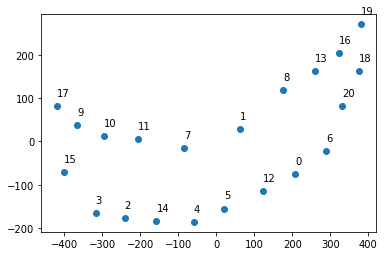

In [72]:

j=0
plt.plot(xpoin,-ypoin,'o')
for x,y in zip(xpoin,ypoin):
  label=j
  x=x
  y=-y
  j=j+1
  plt.annotate(label, # this is the text
                 (x,y), # these are the coordinates to position the label
                 textcoords="offset points", # how to position the text
                 xytext=(0,10) # distance from text to points (x,y)
                 )


In [73]:

idx2=idx1.copy()

-419.33084 380.62326
(208.35349, 74.341415)
(61.98555, -29.163473)
(20.347403, 154.68585)
(288.62088, 22.889448)
(175.51274, -117.50722)
(122.53733, 113.993195)
(258.57468, -161.33269)
(321.73117, -203.355)
(374.8007, -161.82602)
(380.62326, -269.8633)
(330.1494, -81.05427)
[(1, 74.341415), (1, -29.163473), (1, 154.68585), (1, 22.889448), (1, -117.50722), (1, 113.993195), (1, -161.33269), (1, -203.355), (1, -161.82602), (1, -269.8633), (1, -81.05427)]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[-74.341415, 29.163473, -154.68585, -22.889448, 117.50722, -113.993195, 161.33269, 203.355, 161.82602, 269.8633, 81.05427]


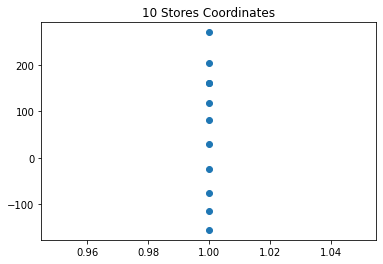

In [74]:
a=[]
b=[]
c=[]
d=min(xpoin)
e=max(xpoin)
print(d,e)
for p in z:
  if( p[0]>0):
    print(p)
    a.append((1,p[1]))
    b.append(1)
    c.append(-p[1])
print(a)
print(b)
print(c)    
xs = b # Selects all xs from the array
ys =c # Selects all ys from the array

plt.title("10 Stores Coordinates")
plt.scatter(x=xs, y=ys)

In [75]:
from sklearn.cluster import KMeans

# The random_state needs to be the same number to get reproducible results
kmeans = KMeans(n_clusters=2, random_state=42) 
kmeans.fit(a)
kmeans.labels_

/usr/local/lib/python3.9/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


array([1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0], dtype=int32)

<AxesSubplot:>

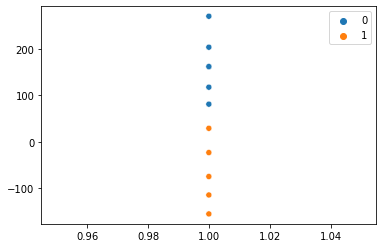

In [76]:
import seaborn as sns
sns.scatterplot(x = b, y = c, hue=kmeans.labels_)

In [77]:
idx2=idx1.copy()
print(len(idx1))
print(idx1)
k=[]
for i in range(len(idx2)):
  a=idx2.argmin()
  print("a===",a)
  print("i===",i)
  k.append(a)
  print("k====",k)
  idx2[a]=float('inf')
  print(idx2)

print("vdbjhfgrevf===",k)  
print("jkkhdjkhckj===",idx1)








21
[128.62009895  39.33565891 145.13198263 191.87333672  34.77146764
  13.93638889 177.58321409  50.06263542 108.58724603 221.23016427
 178.30714101 124.11922586  76.27224633 159.25501919  94.33941267
 242.02687842 197.78049645 254.26734694 230.15290304 233.70465391
 202.91560807]
a=== 5
i=== 0
k==== [5]
[128.62009895  39.33565891 145.13198263 191.87333672  34.77146764
          inf 177.58321409  50.06263542 108.58724603 221.23016427
 178.30714101 124.11922586  76.27224633 159.25501919  94.33941267
 242.02687842 197.78049645 254.26734694 230.15290304 233.70465391
 202.91560807]
a=== 4
i=== 1
k==== [5, 4]
[128.62009895  39.33565891 145.13198263 191.87333672          inf
          inf 177.58321409  50.06263542 108.58724603 221.23016427
 178.30714101 124.11922586  76.27224633 159.25501919  94.33941267
 242.02687842 197.78049645 254.26734694 230.15290304 233.70465391
 202.91560807]
a=== 1
i=== 2
k==== [5, 4, 1]
[128.62009895          inf 145.13198263 191.87333672          inf
          inf

In [78]:
print(k)

[5, 4, 1, 7, 12, 14, 8, 11, 0, 2, 13, 6, 10, 3, 16, 20, 9, 18, 19, 15, 17]


In [79]:
print(upind)
print(downind)

[1, 6, 7, 8, 9, 10, 11, 13, 15, 16, 17, 18, 19, 20]
[0, 2, 3, 4, 5, 12, 14]


In [80]:
upperord=[]
downord=[]
for i in k:
  for j in upind:
    if(i==j):
      upperord.append(i)
  for s in downind:
    if(i==s):
      downord.append(i)

print(upperord)
print(downord)


[1, 7, 8, 11, 13, 6, 10, 16, 20, 9, 18, 19, 15, 17]
[5, 4, 12, 14, 0, 2, 3]


In [95]:
print(area)

tensor([2954.7275, 8844.2148, 2485.5925, 2941.8193, 1411.1497, 1797.5953,
        2816.3010, 7818.3354, 4468.9668, 2178.2080, 4068.4187, 4378.5234,
        3129.3691, 3313.5339, 2302.3828, 1612.0560, 1557.7335, 1249.8380,
        1819.8008, 1015.0773, 1196.6187], device='cuda:0')


In [108]:
area3=area[upperord[0]]
print(upperord[0])
print(area3)
area4=area3.cpu().numpy()
print(area4)

1
tensor(8844.2148, device='cuda:0')
8844.215


In [110]:
bboxmaxss=outputs['instances'][upperord[0].item()].pred_boxes.tensor
print(bboxmaxss)


tensor([[1067.8893,  739.4327, 1158.3286,  837.2244]], device='cuda:0')


In [81]:
p=[]
for i in range(len(k)):
    p.append(k[i])
print(p)   

[5, 4, 1, 7, 12, 14, 8, 11, 0, 2, 13, 6, 10, 3, 16, 20, 9, 18, 19, 15, 17]


In [82]:
ymax=(cent2[a]+ymax1)/2
print(a)

17


In [83]:
print(cent2[a])
print(ymax)

772.1045351473923
804.6644501908836


In [84]:
upper=[]
lower=[]
for i in p:
  i=i.item()
  bbbox=cent2[i]
  print(bbbox)
  print(ymax)
  if(bbbox>ymax):
    lower.append(i)
  if(bbbox<=ymax):
    upper.append(i)
print("lower=",lower)
print("upper",upper)     


850.3348611111111
804.6644501908836
860.5142813734427
804.6644501908836
789.6645833333333
804.6644501908836
804.4309145880575
804.6644501908836
836.9062822897292
804.6644501908836
859.6848016486347
804.6644501908836
760.5111473626971
804.6644501908836
797.2064053443364
804.6644501908836
823.8211966604824
804.6644501908836
857.7762662807526
804.6644501908836
746.0487443614085
804.6644501908836
806.842047330765
804.6644501908836
795.1126231207879
804.6644501908836
853.530218384967
804.6644501908836
732.1813829787234
804.6644501908836
772.5406203840473
804.6644501908836
786.948906997801
804.6644501908836
745.8859416445623
804.6644501908836
710.2336404441295
804.6644501908836
822.7797131147541
804.6644501908836
772.1045351473923
804.6644501908836
lower= [5, 4, 12, 14, 0, 2, 6, 3, 15]
upper [1, 7, 8, 11, 13, 10, 16, 20, 9, 18, 19, 17]


In [85]:


i=2

In [86]:
# print(outputs["instances"])
output={}
out1=outputs["instances"]
inp=out1[i]
# print(out1)
# print(out1[i])
output["instances"]=out1[i]
# print("ololololo",output)


In [87]:
# print(idx1)
# idx1[i]=float('inf')
# print(i)
# print(idx1[i])
# print(idx1)

In [88]:
print(output)

{'instances': Instances(num_instances=1, image_height=1536, image_width=2048, fields=[pred_boxes: Boxes(tensor([[903.5602, 831.3887, 950.2419, 884.6342]], device='cuda:0')), scores: tensor([0.9859], device='cuda:0'), pred_classes: tensor([0], device='cuda:0'), pred_masks: tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]]], device='cuda:0')])}


In [89]:
# print(d["file_name"])

In [90]:

def visualise(output):
   img=im
  #  img = cv2.imread(d["file_name"])
  #  img = cv2.imread("/content/drive/MyDrive/teeth-mask-rcnn/COMPOSITE_PHOTO-HIKJH87566_020821083048.jpeg")
   v = Visualizer(img,
                   metadata=balloon_metadata, 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
       )
   out = v.draw_instance_predictions(output["instances"].to("cpu"))
  #  cv2_imshow(out)
   
  #  ratio_h,ratio_w=scaler(out.get_image(),im)
  #  print("lll=",scaler(out.get_image(),im))
  #  org1=[]
  #  org1[0]=org[0]*ratio_h
  #  org1[1]=org[1]*ratio_w
  #  print("lklklkkj=",out.get_image())
  #  print("out===",output["instances"])
  #  image = cv2.putText(out.get_image(), "ippppppppppppppppp", org1, font, 
  #                  fontScale, color, thickness, cv2.LINE_AA)
  #  print(out.get_image().shape)
   cv2_imshow(out.get_image())

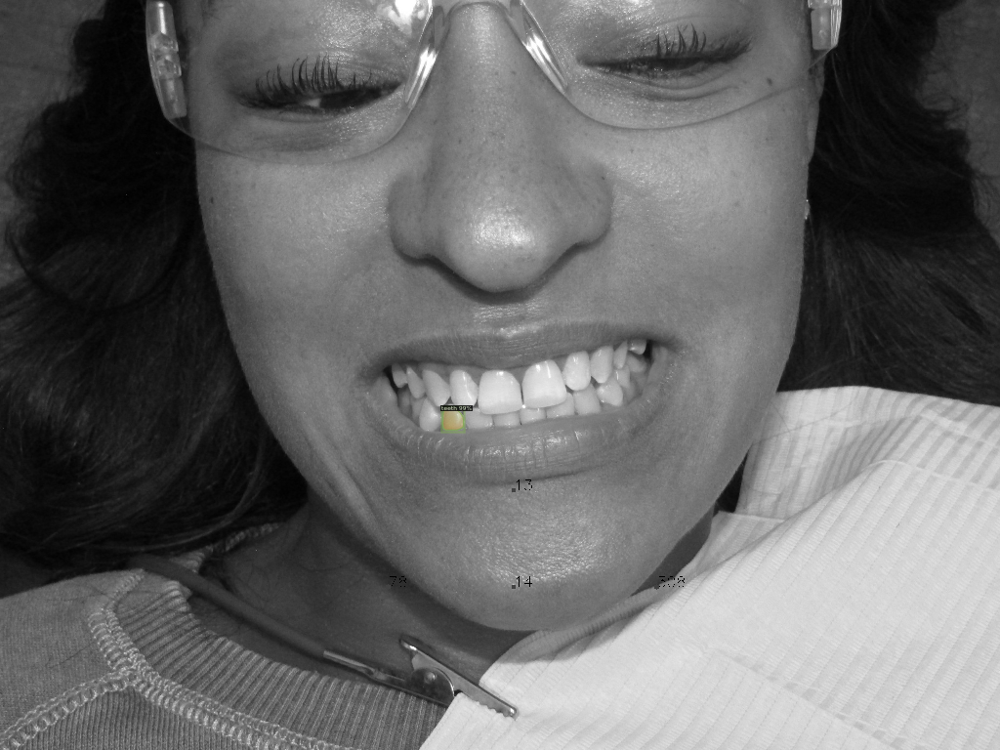

In [91]:
visualise(output)

In [92]:
print(idx1)
idx1[i]=float('inf')
print(i)
print(idx1[i])
print(idx1)

[128.62009895  39.33565891 145.13198263 191.87333672  34.77146764
  13.93638889 177.58321409  50.06263542 108.58724603 221.23016427
 178.30714101 124.11922586  76.27224633 159.25501919  94.33941267
 242.02687842 197.78049645 254.26734694 230.15290304 233.70465391
 202.91560807]
2
inf
[128.62009895  39.33565891          inf 191.87333672  34.77146764
  13.93638889 177.58321409  50.06263542 108.58724603 221.23016427
 178.30714101 124.11922586  76.27224633 159.25501919  94.33941267
 242.02687842 197.78049645 254.26734694 230.15290304 233.70465391
 202.91560807]


In [93]:
print(out1)
print(out1[1])


Instances(num_instances=21, image_height=1536, image_width=2048, fields=[pred_boxes: Boxes(tensor([[1173.1516,  798.0757, 1228.4321,  851.5255],
        [1067.8893,  739.4327, 1158.3286,  837.2244],
        [ 903.5602,  831.3887,  950.2419,  884.6342],
        [ 857.7536,  820.6037,  905.7921,  881.8425],
        [1010.4219,  847.6868, 1064.2939,  873.8812],
        [1060.5823,  834.5928, 1114.3822,  868.0054],
        [1220.0125,  781.6871, 1274.7531,  833.1353],
        [ 978.8819,  759.0658, 1067.4696,  847.3211],
        [1150.0457,  722.4895, 1208.3269,  799.1688],
        [ 833.8898,  755.4471,  869.8445,  816.0292],
        [ 866.2712,  758.4423,  921.5007,  832.1061],
        [ 919.2983,  758.8565,  976.2337,  835.7598],
        [1111.0236,  810.5392, 1176.2802,  858.4941],
        [1207.0309,  711.3346, 1253.3062,  782.9395],
        [ 949.9244,  840.4766, 1008.5322,  879.7611],
        [ 815.5778,  796.1401,  844.8477,  851.2157],
        [1255.1710,  706.2650, 1284.3873,  75

In [ ]:
cv2_imshow(im)

We can also evaluate its performance using AP metric implemented in COCO API.
This gives an AP of ~70. Not bad!

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("balloon_val", output_dir="./output")
val_loader = build_detection_test_loader(cfg, "balloon_val")
print(inference_on_dataset(predictor.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

# Other types of builtin models

We showcase simple demos of other types of models below:

In [ ]:
# Inference with a keypoint detection model
cfg = get_cfg()   # get a fresh new config
cfg.merge_from_file(model_zoo.get_config_file("COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7  # set threshold for this model
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(im)
v = Visualizer(im[:,:,::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
# Inference with a panoptic segmentation model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml"))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml")
predictor = DefaultPredictor(cfg)
panoptic_seg, segments_info = predictor(im)["panoptic_seg"]
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_panoptic_seg_predictions(panoptic_seg.to("cpu"), segments_info)
cv2_imshow(out.get_image()[:, :, ::-1])

# Run panoptic segmentation on a video

In [ ]:
# This is the video we're going to process
from IPython.display import YouTubeVideo, display
video = YouTubeVideo("ll8TgCZ0plk", width=500)
display(video)

In [ ]:
# Install dependencies, download the video, and crop 5 seconds for processing
!pip install youtube-dl
!youtube-dl https://www.youtube.com/watch?v=ll8TgCZ0plk -f 22 -o video.mp4
!ffmpeg -i video.mp4 -t 00:00:06 -c:v copy video-clip.mp4

In [ ]:
# Run frame-by-frame inference demo on this video (takes 3-4 minutes) with the "demo.py" tool we provided in the repo.
!git clone https://github.com/facebookresearch/detectron2
# Note: this is currently BROKEN due to missing codec. See https://github.com/facebookresearch/detectron2/issues/2901 for workaround.
%run detectron2/demo/demo.py --config-file detectron2/configs/COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml --video-input video-clip.mp4 --confidence-threshold 0.6 --output video-output.mkv \
  --opts MODEL.WEIGHTS detectron2://COCO-PanopticSegmentation/panoptic_fpn_R_101_3x/139514519/model_final_cafdb1.pkl

In [ ]:
# Download the results
from google.colab import files
files.download('video-output.mkv')